In [1]:
import pandas as pd
import numpy as np
from typing import List, Union, NamedTuple

In [2]:
# Ucitavanje obradenih Biancinih podataka
df = pd.read_csv('active im en.csv')
df = df.drop(['Unnamed: 0'], axis=1).reset_index(drop=True)

In [3]:
IDs = ['ZIV0034902130', 'ZIV0034902131', 'ZIV0034704030', 'ZIV0034703915', 'ZIV0034704013',
       'ZIV0034703953', 'ZIV0034703954']
duzina = len(IDs)

In [4]:
zgrade = [df[ID].values for ID in IDs]

Time resolution, T: 3600s (1h); Number of samples, N: 8760
Frequency resolution: 1/N*T = 31.71nHz

All waves carry energy. The amount of energy in a wave is related to its amplitude and its frequency.

signal je kompleksna funkcija frekvencija

whenever the signal (function) and analayzing function (sinusoids) are similar, they will multiply and sum to a large coefficient. And wherever the function and analyzing function are dissimilar they will multiply and sum to a small coefficient. 

frequency bins are intervals between samples in frequency domain. The bin width (also called line spacing) defines the frequency resolution of the FFT.

In [5]:
from scipy.fft import fft, fftfreq
import matplotlib.pyplot as plt

In [6]:
from scipy.fft import rfft, rfftfreq

Frequency is the number of wave cycles passing a point per unit time. It is another important wave parameter, but there is no relationship between amplitude and frequency. Changing one does not affect the other. Amplitude cannot be calculated from frequency, and frequency cannot be calculated from amplitude.

Realni dfft se radi zbog pocetnog sagledavanja frekvencija. Zatim ih prebacujem u sate da mi budu nesto jasnije dnevne aktivnosti zgrade.

/home/donata/anaconda3/lib/python3.7/site-packages/ipykernel_launcher.py:7: RuntimeWarning: divide by zero encountered in true_divide
  import sys


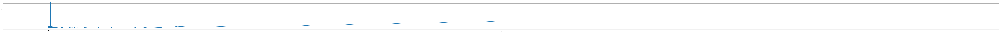

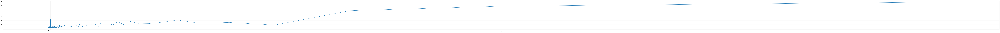

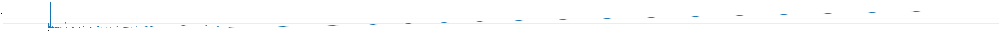

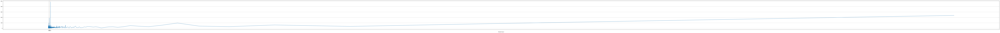

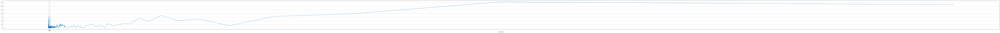

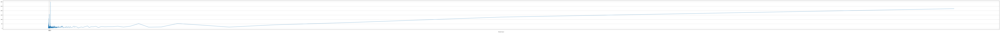

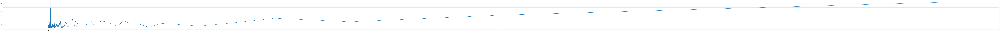

In [7]:
NUMBER_OF_SAMPLES = 8760
TIME_RESOLUTION = 3600 # [s], 1/sample_rate

xf_rfft: np.ndarray = rfftfreq(NUMBER_OF_SAMPLES, TIME_RESOLUTION)
n_rfft = len(xf_rfft)
# f=1/t => t = 1/f ([s]) /3600 ([h])
th: np.ndarray = 1/xf_rfft/TIME_RESOLUTION

for i in range(len(zgrade)):
    
    fig = plt.figure(figsize=(200,6))
    fig.patch.set_facecolor('white')

    yf: np.ndarray = rfft(zgrade[i]) # real fft
    # normalizacija sa faktorom: 1/n ==> yf = magnitude of each frequency bin
    plt.plot(th, np.abs(yf / n_rfft))
    
    plt.xticks([6,12,15,24])
    plt.xlabel('Period ($hour$)')
    plt.grid()
    plt.show()

Iz grafova je vidljivo da je najcesce periodicno ponavljanje svako 24 sata, a ostala jaca su aktivnosti sa intervalom ponavljanja manjim od 24 sata. Stoga ce se clusteri potrosnje raditi unutar 24 sata, za svaki mjesec i svaku zgradu. Ako se kod nekih zgrada clusteri slucajno preklope, znaci da ih mozemo svrstati u njihov posebni cluster.

Sada je za svaki mjesec potrebno sve podatke smjestit u 24h (preklopiti)

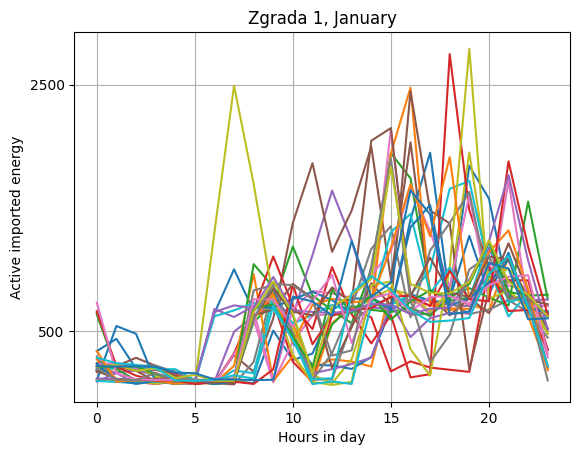

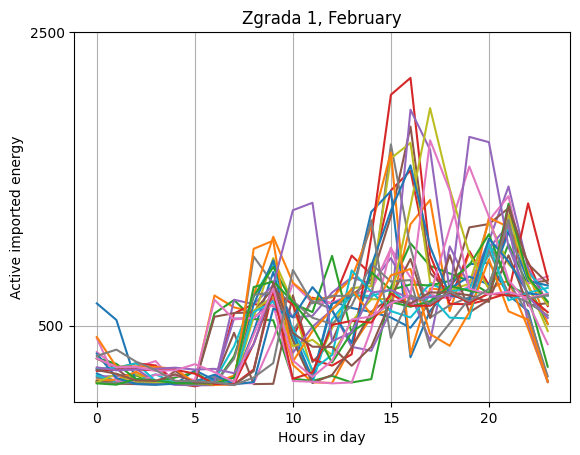

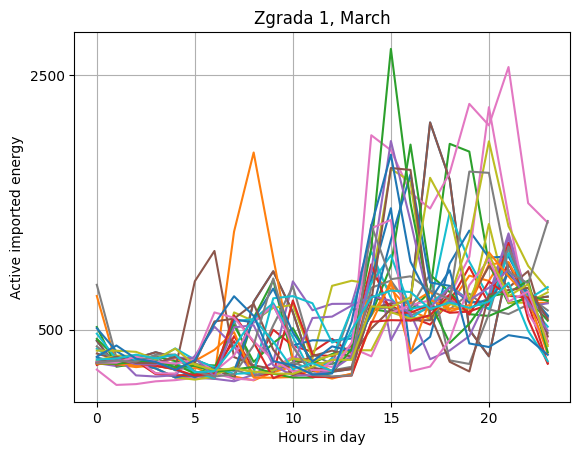

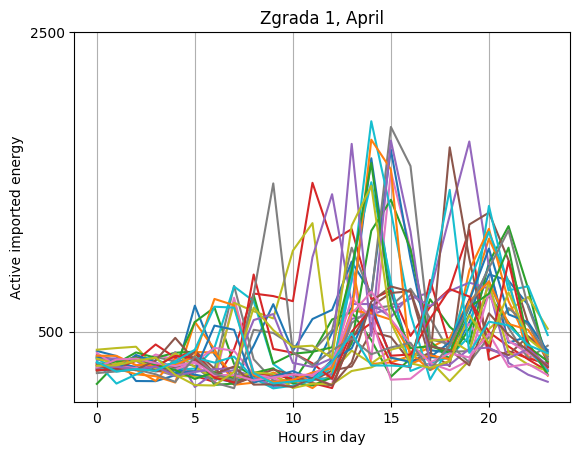

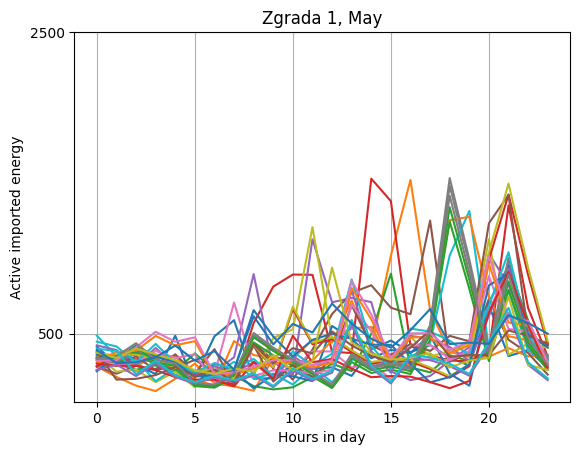

...

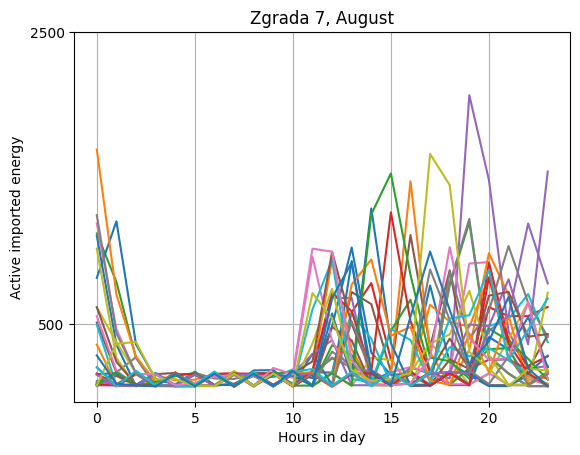

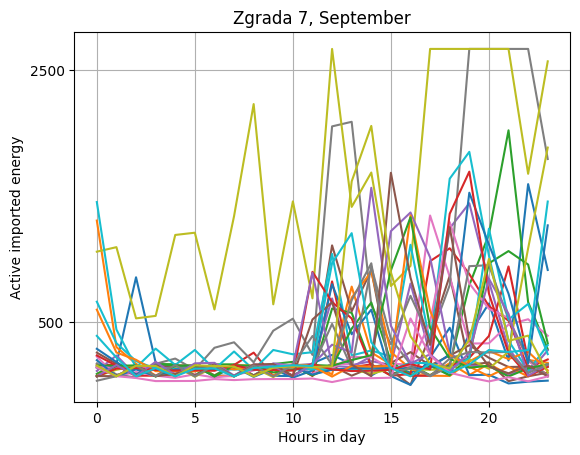

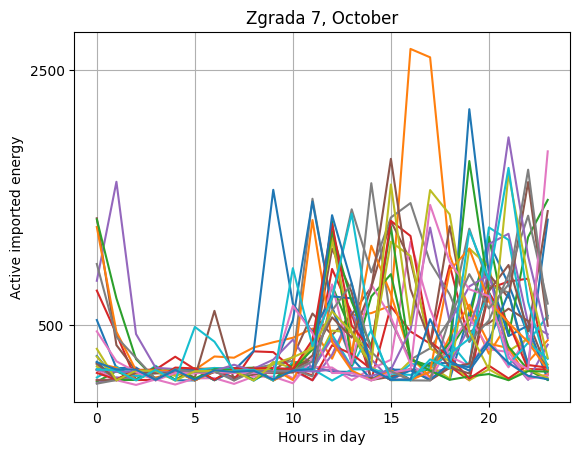

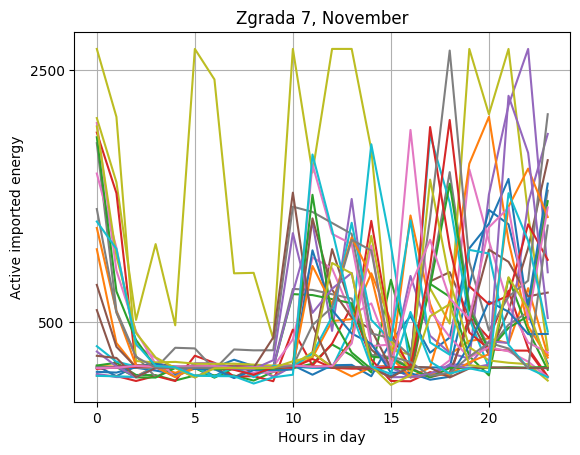

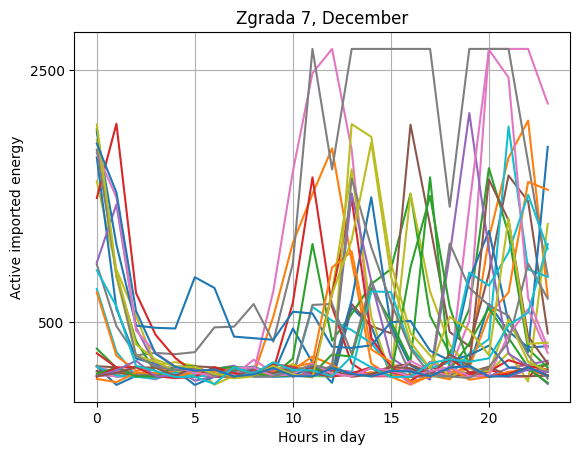

In [8]:
broj_dana = [31, 28, 31, 30, 31, 30, 31, 31, 30, 31, 30, 31]
mjeseci = ['January', 'February', 'March', 'April', 'May', 'June', 'July', 'August', 'September', 
           'October', 'November', 'December']
SATI_U_DANU = 24
lista_sati_u_danu = list(range(SATI_U_DANU))

for k, zg in enumerate(zgrade):
    
    # broji koliko je dana proslo poslije svakog mjeseca
    a = 0

    #Za svaki mjesec radimo preklapanje
    for mjesec, broj in enumerate(broj_dana):

        #svaki dan je svoja "funkcija" koju prikazujemo na grafu
        fig = plt.figure()
        fig.patch.set_facecolor('white')

        for dan in range(broj):

            #                                     broj dana od preth mj*24 sata + trenutni redni broj dana*24 sata
            plt.plot(lista_sati_u_danu, zg[a*SATI_U_DANU+dan*SATI_U_DANU : a*SATI_U_DANU+(dan+1)*SATI_U_DANU])
            plt.title("Zgrada " + str(k+1) + ", " + mjeseci[mjesec])
        plt.xlabel('Hours in day')
        plt.ylabel('Active imported energy')
        plt.yticks([500, 2500])
        plt.grid()
        plt.show()

        a += broj
    

### Pokusat cu clusterirat sa: dbscan i affinity propagation

DBSCAN is *density-based* data clustering algorithm. To cluster data points, this algorithm separates the high-density regions of the data from the low-density areas. Algorithm group points based on distance measurment (usually the euclidian distance and the minimum number of points. 

Koristan jer ne uracunava outlinere!!

In [9]:
from sklearn.neighbors import NearestNeighbors
from sklearn.cluster import DBSCAN
from kneed import KneeLocator

U redu je izbacit peakove, to su samo dodatno ukljuceni uredaji koji povecavaju ukupnu potrosnju energije. Znaci
razmatraj sve clustere preko 500 Wh (ovo niže radi konstantno i mislim da se ne bi trebali dirat u to. Mozda u nekoj drugoj zgradi bude dostupna fleksibilnost!

In [10]:
dot_coordinates = List[Union[int,float]]

In [11]:
def jeli_tocka_zadovoljava_uvjet(lab: int, vrijednost: float) -> bool:
    
    """
    Funkcija provjerava jeli tocka outlier (lab == -1), jeli u prvome sloju (lab == 0) te jeli se nalazi
    u zeljenom rasponu ([500, 2500>). Ako se nalazi vraca "True", u suprotnome vraca "False"
    """
    
    MIN_VALUE = 500
    MAX_VALUE = 2500
    
    if lab > 0 and MIN_VALUE <= vrijednost < MAX_VALUE:
        return True
    return False

In [12]:
def odabrane_tocke(list_of_all_dots: List[dot_coordinates], labels: np.ndarray) -> List[dot_coordinates]:
    
    """
    :param list_of_all_dots
           labels: array that connects each dot with its cluster
    :return: tocke: list of dots to consider for flexibility
    """
    
    filtered_dots = []

    # ako postoji vise od jednog clustera, razmatramo
    if max(labels) > 0:
        
        filtered_dots = [[index, vrijednost] for index, vrijednost, lab in zip(list_of_all_dots[:,1],
                                                                              list_of_all_dots[:,0], labels) if 
                        jeli_tocka_zadovoljava_uvjet(lab, vrijednost)]

    return filtered_dots

In [14]:
def finding_elbow_of_the_graph(x: np.array) -> float:
    
    """
    Funkcija racuna udaljenosti svake tocke od njenog najblizeg susjeda iz polja kojeg primi, sortira ih te 
    na kraju iz grafa pronalazi potrebni "elbow" od kojeg vraca y-koordinatu.
    """
    
    neighb = NearestNeighbors(n_neighbors = 8)
    nbrs = neighb.fit(x)
   
    # finding the nearest neighbours
    distances, indices = nbrs.kneighbors(x)

    ## Sorting the distances between the data points
    distances: np.ndarray = np.sort(distances, axis=0)
    distances: np.ndarray = distances[:, 1] # taking the second column of the sorted distances

    # finding "elbow" of the graph
    kn = KneeLocator(range(len(distances)), distances, curve='convex', direction='increasing')
    
    return kn.knee_y

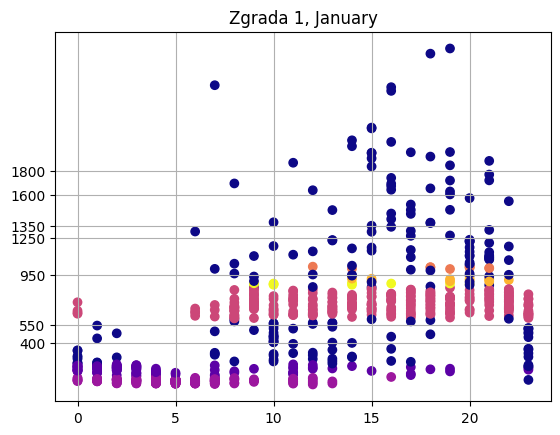

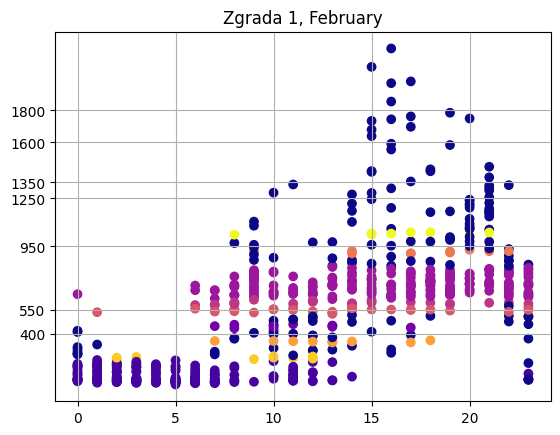

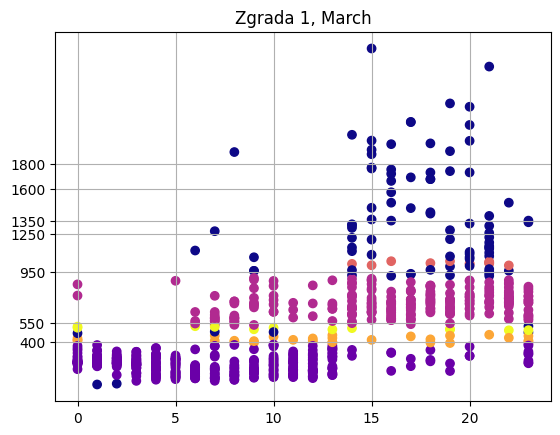

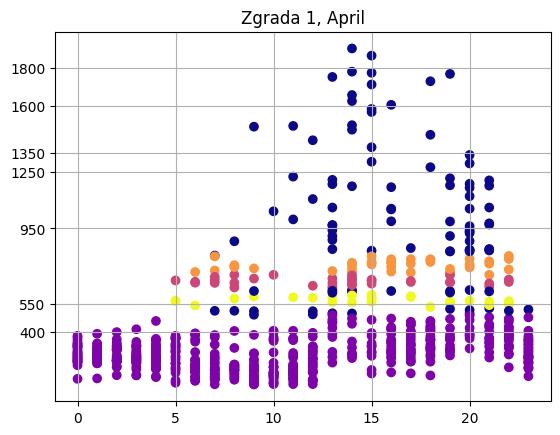

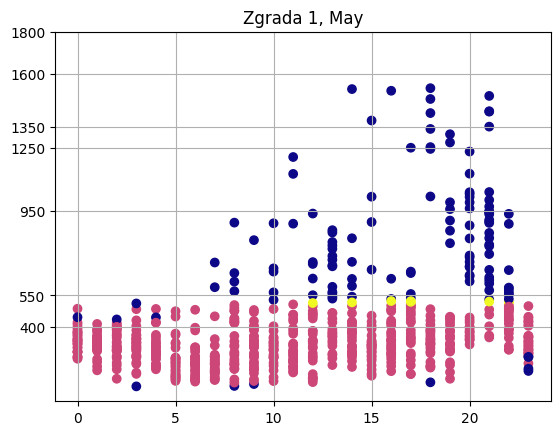

...

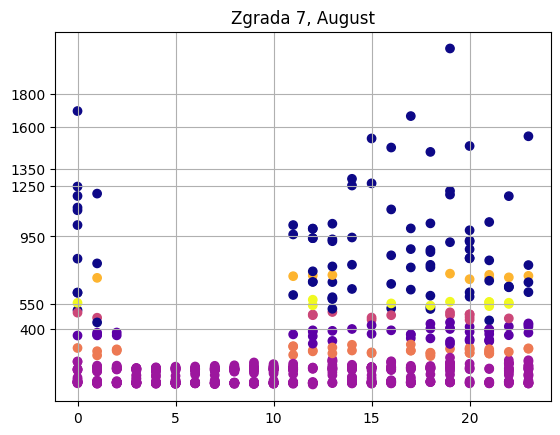

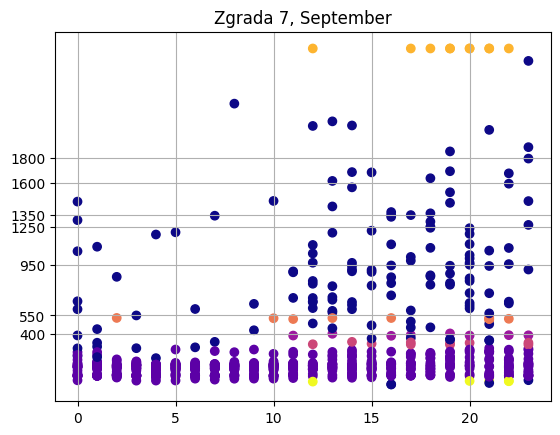

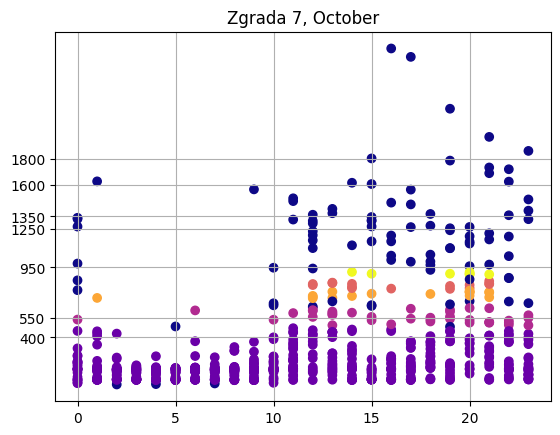

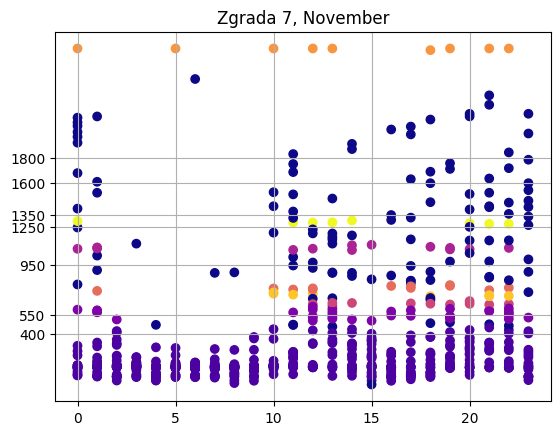

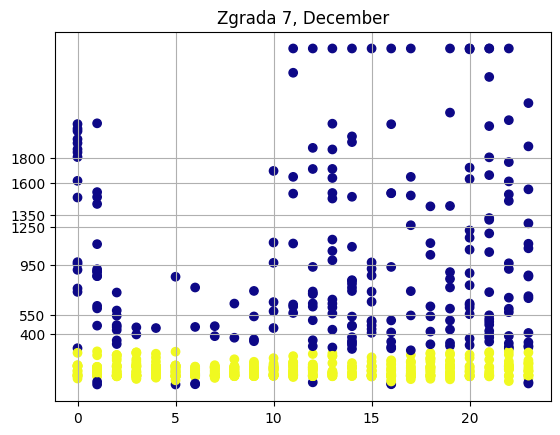

In [15]:
# trebam spremati tocke koje cu gledat
tocke_za_razmatranje = {mjesec: [] for mjesec in mjeseci}

# za svaku zgradu
for ID in range(len(IDs)):
    
    # prati broj sati od svih dana koji su prosli, za svaku zgradu
    b = 0

    # za svaki mjesec
    for i, j in enumerate(broj_dana):

        # lista sa svim satima unutar dana za trenutni mjesec
        xx: list = j*lista_sati_u_danu

        # potrebno je nalijepiti ovaj dodatni stupac, dim = 2
        xxx = np.array([zgrade[ID][b : b + j*SATI_U_DANU], xx]).transpose()

        # Racunanje vrijednosti epsilona: racunanje udaljenosti izmedu svake tocke i njenog najblizeg susjeda koristeci
        # Nearest Neighbours. Elbow od grafa nam predstavlja najbolju vrijednost za epsilon 

        elbow = finding_elbow_of_the_graph(xxx)
        args = [elbow, 8] if elbow <= 20 else  [20,16]
            
        # fitting the data
        dbscan = DBSCAN(eps = args[0], min_samples = args[1]).fit(xxx)                   
        labels: np.ndarray = dbscan.labels_ 
        
        # Plot the clusters
        plt.scatter(xxx[:, 1], xxx[:,0], c = labels, cmap= "plasma")
        plt.yticks([400, 550, 950, 1250, 1350, 1600, 1800])
        plt.grid()
        plt.title("Zgrada " + str(ID+1) + ", " + mjeseci[i])
        plt.show()
            
        # resetiranje broja dana
        b += j*SATI_U_DANU
        
        
        # spremanje tocaka koje ce se promatrati
        tocke_za_razmatranje[mjeseci[i]].append(odabrane_tocke(xxx, labels))

In [16]:
def racunanje_baselineova(tocke: List[dot_coordinates]) -> tuple:
    
    """
    Funkcija ucitava tocke koje se uzimaju u obzir te racuna min, mid i max baseline sa kojima ih se moze
    opisat. Takoder racuna razlike izmedu mid i max. Sve vraca u tuple-u.
    """
    
    ZADNJI_SAT = 23
    
    # spremaju se i x-evi i y-oni
    min_base = []
    max_base= []
    
    ## Sortiranje
    a: list = tocke.tolist()
    b:list = sorted(a, key=itemgetter(0,1)) # sortiranje po prvom pa po drugom elementu

    alert = 0
    trenutni_sat = 0
    for x, y in enumerate(b):
            
        # nasli smo prvu minimalnu uru
        if alert == 0:
            min_base.append(y)
            alert = 1
            trenutni_sat = y[0]
        elif y[0] == trenutni_sat:
            continue
        elif y[0] != trenutni_sat:
                
            # dodaj prethodni kao maksimalni
            max_base.append(b[x-1])
                
            # za novi sat= novi minimalni
            min_base.append(y)    
            trenutni_sat = y[0]
                
    max_base.append(y)

    ## Popuniti sate koji nedostaju sa: np.nan
    # prvo rijesiti ako nedostaje na pocetku i na kraju jer to daje probleme kod interpolacije
    # ako nedostaje na pocetku = dodat minimalnu vrijednost od ponoca, a za maksimalnu nadodat jos pola razlike 
    # od ponoca
    # ako nedostaje na kraju = dodat minimalnu od zadnje, a za maksimalnu takoder dodat jos pola razlike
    if min_base[-1][0] != ZADNJI_SAT:

        min_base.insert(ZADNJI_SAT, [ZADNJI_SAT,min_base[-1][1]])
        max_base.insert(ZADNJI_SAT, [ZADNJI_SAT,min_base[-1][1] + (max_base[-1][1]-min_base[-1][1])/2])

    if min_base[0][0] != 0:

        min_base.insert(0, [0,min_base[-1][1]])
        max_base.insert(0, [0,min_base[-1][1] + (max_base[-1][1]-min_base[-1][1])/2])
        
    
    # popunavanje sa np.nan
    for sat in range(SATI_U_DANU):
        
        # nedostaje jedan sat
        if min_base[sat][0] != sat:
            
            min_base.insert(sat, [sat,np.nan])
            max_base.insert(sat, [sat,np.nan])
            

    min_base = np.array(min_base)
    max_base = np.array(max_base)
    
    # interpolacija podataka drugog stupca
    temp_min: list = pd.Series(min_base[:,1]).interpolate(method="linear", order=1).tolist()
    temp_max: list = pd.Series(max_base[:,1]).interpolate(method="linear", order=1).tolist()
           
    min_base = np.array(min_base)
    min_base[:,1] = temp_min
    max_base = np.array(max_base)
    max_base[:,1] = temp_max
    
    # radim srednji baseline
    mid_base = []
    
    
    # uz racunanje mid_basleine, korisno je zapamtiti i razlike izmedu njega i max_baseline
    # 20% od tih razlika je zapravo max moguca fleksibilnost
    r = []
    for x, vr1, vr2 in zip(min_base[:,0], min_base[:,1], max_base[:,1]):
        mid_base.append([x, (vr1+vr2)/2])
        r.append([x, (vr2-vr1)/2])
        
    mid_base = np.array(mid_base) 
    
    
    return (min_base, max_base, mid_base, r)

In [17]:
from operator import itemgetter

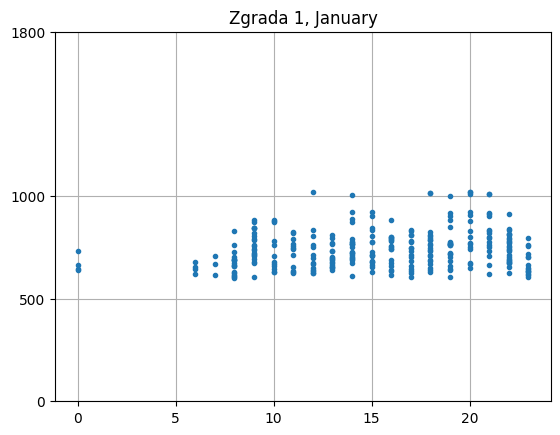

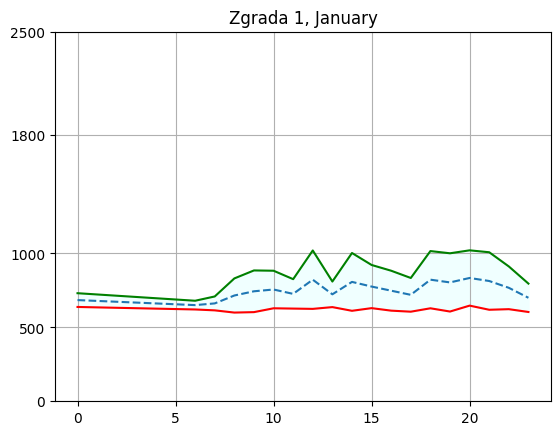

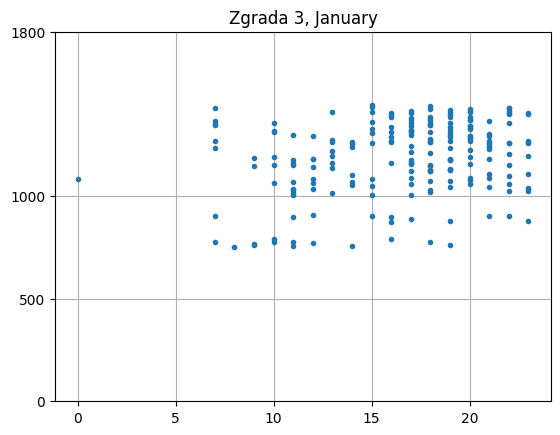

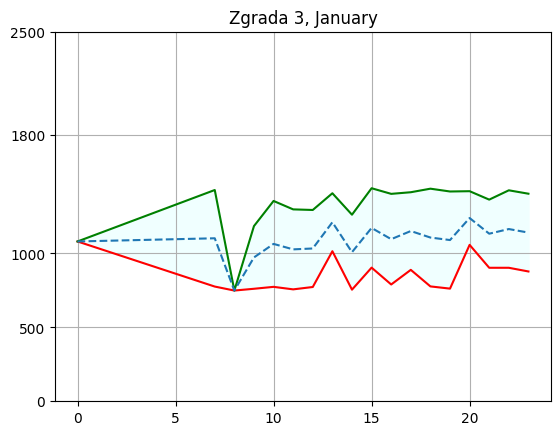

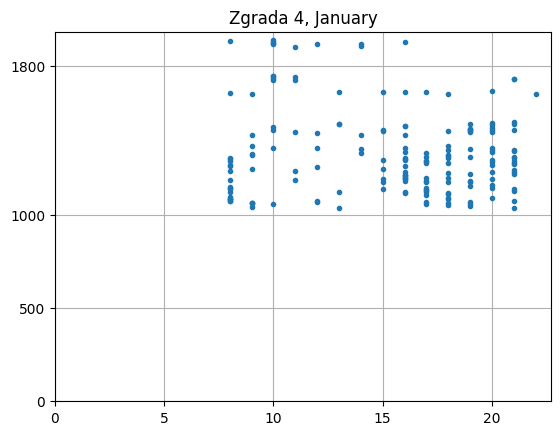

...

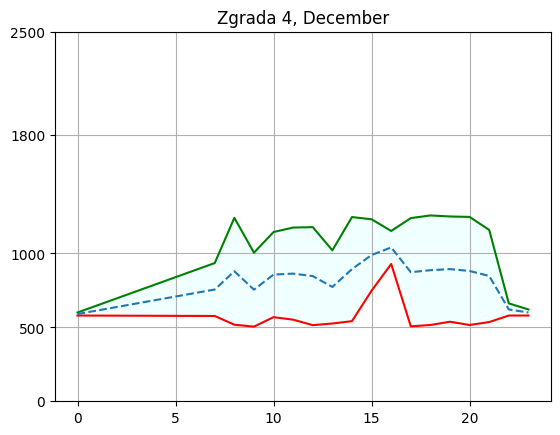

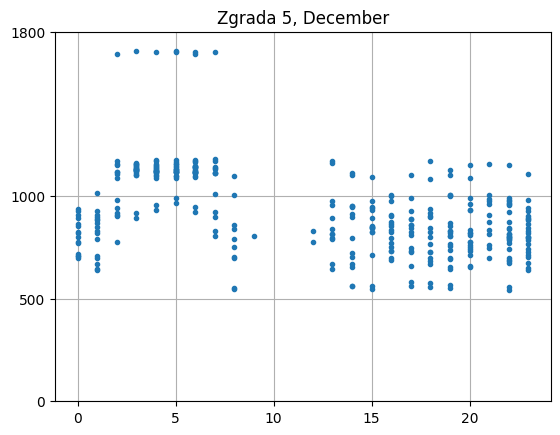

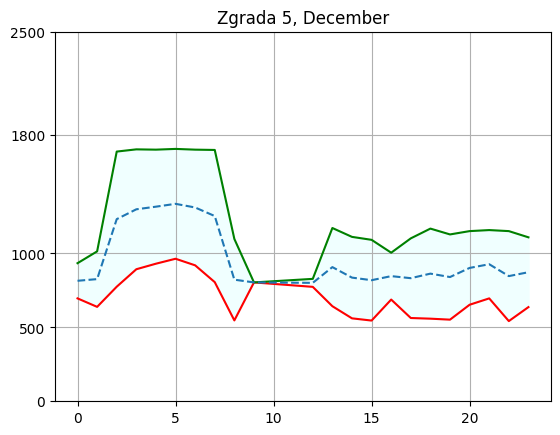

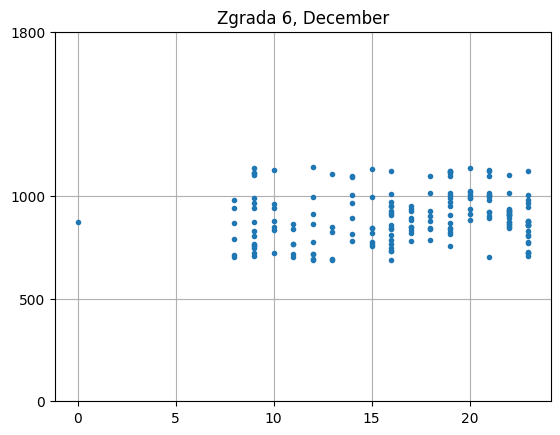

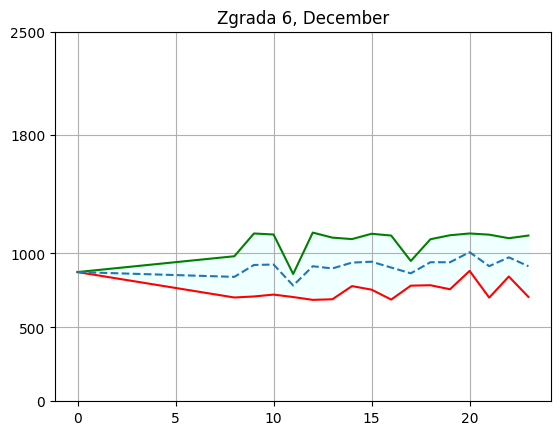

In [18]:
# ovdje cu po svakom mjesecu za svaku zgradu spremati razlike izmedu max i mid baselinea
max_razlike = {mjesec: [] for mjesec in mjeseci}

BROJ_MJESECI = 12

# ovo sluzi za kad nema fleksibilnosti
nista = [[i,0] for i in range(SATI_U_DANU)]

# po mjesecima razmotri fleksibilnosti od zgrada. Ne triba prikazivati zgrade di nema fleksibilnosti
for mj in range(BROJ_MJESECI):
    
    # po zgradama gledam jeli ima tocaka za razmotriti
    for ID in range(len(IDs)):
        
        tocke: list = tocke_za_razmatranje[mjeseci[mj]][ID]
        
        if len(tocke) > 40:
            
            tocke = np.array(tocke)
            
            # plotanje da vidimo kako izgleda
            plt.figure()
            plt.plot(tocke[:,0], tocke[:,1], '.')
            plt.yticks([0,500,1000,1800])
            plt.xticks([0,5,10,15,20])
            plt.grid()
            plt.title("Zgrada " + str(ID+1) + ", " + mjeseci[mj])
            plt.show()

            # racunanje baselineova
            min_baseline, max_baseline, mid_baseline, raz = racunanje_baselineova(tocke)
            
            # spremanje razlike
            max_razlike[mjeseci[mj]].append(raz)

            # prikaz prethodne slike uz dana ogranicenja sati te min i max baseline
            plt.figure()
            fig.patch.set_facecolor('white')
            plt.plot(min_baseline[:,0], min_baseline[:,1], 'r')
            plt.plot(max_baseline[:,0], max_baseline[:,1], 'g')
            plt.fill_between(min_baseline[:,0], min_baseline[:,1], max_baseline[:,1], color='#F0FFFF')
            plt.plot(mid_baseline[:,0], mid_baseline[:,1], '--')
            plt.yticks([0,500,1000,1800, 2500])
            plt.xticks([0,5,10,15,20])
            plt.grid()
            plt.title("Zgrada " + str(ID+1) + ", " + mjeseci[mj])
            plt.show()
            
        else:
            
            # ako nema smisla razmatrati fleksibilnosti samo dodaj nule za tu zgradu u tom mjesecu
            max_razlike[mjeseci[mj]].append(nista)
        

Sljedeće je primijeniti fleksibilnost. Nakon danog upita o kolicini potrebne energije, izracunati kada bi se fleksibilnost mogla primijeniti. Kada treba biti manja potrosnja: mogu je smanjiti od maksimalne za 20% AKO nece dodirnuti mid_baseline. Mislim da nije potreban graf za to, samo odgovor: jeli moze, ili ne moze u danom intervalu biti smanjena potrosnja.

Kako izgleda upit za fleksibilnost? Kakvu formulu iskoristit?

x = potrebna energija
t1 = pocetno vrijeme
t2 = konacno vrijeme
y1 = pocetna energija (zelena linija)

1) pogledati sve zgrade te vidjeti u danom intervalu koje mogu dati fleksibilnost. Prvo poceti od one koja ima 
   najveci razmak izmedu max i mid baselinea
2) u prvom satu je moguce dati fleksibilnosti: 0.15y1 (ako dode do mid_baselinea- onda manje- odredi koliko manje)
3) od x se oduzme 0.15y1 i krece se na drugi sat
4) petlja se ponavlja dok x nije jednak 0 i dok nismo dosli do t2
5) kad je gotova petlja javljamo jeli moguce dati fleks (sve koliko se trazilo- uz vremena odkad-dokad), ili
   ako nije koliko bi mogli dat zapravo (opet uz vremenski period- vjv onda cijeli)

- Izracunati nesto sta bi bia confidence factor za svaku zgradu- mozda da to pomogne  u odabiru eventualnog izbacivanja zgrade

In [19]:
class TimeInterval(NamedTuple):
    from_t: int
    to_t: int

In [20]:
def pozbroji_poredaj(r: np.ndarray, interval: TimeInterval) -> List[List[Union[int,float]]]:
    
    """
    Funkcija prima razlike "r" i vremenski period [t1,t2>. Zatim ih zbraja, uzima 20% te sortira silazno po
    kolicini fleksibilnosti koju svaka zgrada moze pruzit.
    """
    
    red = []
    
    # za svaku zgradu koju gledamo
    for zgrada in range(len(r)):
        
        if sum(np.array(r[zgrada][interval.from_t:interval.to_t])[:,1]) > 0:
            red.append([zgrada, round(sum(np.array(r[zgrada][interval.from_t:interval.to_t])[:,1])*0.2, 2)])
    
    return sorted(red, key=itemgetter(1), reverse=True) 

In [21]:
def izracun_cf(red: List[List[Union[int,float]]], fleks: float) -> List[tuple]:
    
    """
    Funkcija prima listu sa mogucim fleksibilnostima (red, dobiven iz funkcije "poredaj_pozbroji") i potrebnu 
    kolicinu fleksibilnosti (fleks).
    Vraca listu tupleova sa brojem zgrade i confidence factorima.
    """
    y = [(r[0], round(r[1]/fleks, 2)) for r in red]
    
    return y
    

Fleksibilnost moze predstavljati smanjenje ili povecanje potrosnje energije. Kako je srednji baseline aritmeticka sredina gornjeg i donjeg, zapravo je svejedno kakvi je upit pa cu gledat samo smanjenje. Povecanje ide analogno 

In [22]:
class BuildingInfo(NamedTuple):
    number: int
    time_interval: TimeInterval
    flex: float

In [23]:
def primijeni_fleks(razlike: List[List[dot_coordinates]], interval: TimeInterval, fleks: float) -> List[BuildingInfo]:
    
    """
    Funkcija prima listu razlika potrebnog mjeseca "razlike", vremenski interval kada je potrebna fleksibilnost
    [t1,t2> te potrebnu kolicinu fleksibilnosti "fleks".
    Funkcija vraca listu zgrada (BuildingInfo), sa podatcima: koliko fleksibilnosti koja zgrada, kada i koliko moze 
    dati fleksibilnosti.
    """
    
    # za dani period- vidjeti kojim redoslijedom ce se promatrati zgrade
    # pozbrajati razlike u danom periodu od svake zgrade te ih sortirati od najvece
    
    # redoslijed sadrzi prvo indeks zgrade, zatim maks mogucu fleks koju moze dati za taj period
    redoslijed: list = pozbroji_poredaj(np.array(razlike), interval)
    
    # spremati zgrade koje ce biti iskoristene uz periode kada ce biti iskoristene i koliko
    rezultat = []
    
        
    # prolazi po svim zgradama koje bi mogle dati fleks
    for zgrada in range(len(redoslijed)):
        
        # za zgradu pamti koliko je dala fleks
        koliko = 0
        
        if fleks > 0:

            # ovo je zadnja zgrada u nizu koja ce se promatrati
            if redoslijed[zgrada][1] >= fleks:

                pocetak = -1 
                # naci odkad dokad ce se iskoristavat fleks
                for sat in range(interval.from_t, interval.to_t):

                    # nasli pocetak          
                    if razlike[redoslijed[zgrada][0]][sat][1] > 0 and pocetak == -1:
                        pocetak = sat
                        
                    # provjeri jeli ponuda veca od potraznje
                    if fleks <= razlike[redoslijed[zgrada][0]][sat][1]:
                        
                        koliko += fleks
                        fleks = 0
                        kraj = sat+1
                        break
                    
                    # trebat ce jos sati iskoristit pa idemo dalje
                    else:
                        
                        koliko += razlike[redoslijed[zgrada][0]][sat][1]
                        fleks -= razlike[redoslijed[zgrada][0]][sat][1]
                    
                rezultat.append(BuildingInfo(number=redoslijed[zgrada][0],
                                             time_interval = TimeInterval(pocetak,kraj),
                                            flex=round(koliko, 2)))
                break

            # uz ovu zgradu, bit ce ih jos koje triba iskoristit
            else:

                # iskoristimo potpunu fleksibilnost ove zgrade
                fleks -= redoslijed[zgrada][1]

                # od koje do koje ure? mozda su na pocetku, ili kraju intervala nule
                for sat in range(interval.from_t, interval.to_t):

                    # nasli pocetak          
                    if razlike[redoslijed[zgrada][0]][sat][1] > 0:
                        pocetak = sat
                        break

                for sat in reversed(range(interval.from_t, interval.to_t)):

                    # nasli kraj
                    if razlike[redoslijed[zgrada][0]][sat][1] > 0:
                        kraj = sat + 1
                        break

                rezultat.append(BuildingInfo(number=redoslijed[zgrada][0],
                                            time_interval = TimeInterval(pocetak,kraj),
                                            flex=round(redoslijed[zgrada][1], 2)))
                
        else:
            
            # uspjeli pokrit svu fleksibilnost
            break
                
                
    return rezultat
    

In [24]:
list(reversed(range(1,5)))

[4, 3, 2, 1]

In [25]:
interval = TimeInterval(14,17)
interval.from_t

14

In [26]:
# trazi npr 400Wh u periodu od 15-18, za January

interval = TimeInterval(14,17)
rezz = primijeni_fleks(max_razlike['January'], interval, 400)
red = pozbroji_poredaj(np.array(max_razlike['January']), interval)

In [27]:
c_factor = izracun_cf(red, 400)
c_factor

[(5, 0.85), (4, 0.69), (3, 0.48), (2, 0.41), (0, 0.24)]

In [28]:
rezz

[BuildingInfo(number=5, time_interval=TimeInterval(from_t=14, to_t=17), flex=341.4),
 BuildingInfo(number=4, time_interval=TimeInterval(from_t=14, to_t=15), flex=58.6)]

In [29]:
red

[[5, 341.4], [4, 276.0], [3, 191.1], [2, 165.7], [0, 95.3]]

### random radenje upita 
Random vremena u periodu od 7-22. Random trajanje zahtjeva. Po kolicini trajanja- random velicina zahtjeva (izracunata od 0-max moguce za taj period)

In [30]:
def max_fleks(raz: List[List[dot_coordinates]], interval: TimeInterval) -> float:
    
    """
    Funkcija prima rezultat funkcije "max_razlike" te vremenski interval [t1,t2>. Vraca maksimalnu mogucu
    fleksibilnost koja se moze dobiti u tome periodu.
    """
    
    temp: list = pozbroji_poredaj(np.array(raz), interval)
        
    return round(sum(np.array(temp)[:,1], 2))

In [31]:
import random
# prvi random odabir: koliko ce primjena bit (1-3) = 7 razlicitih kombinacija
# ovisno o tome sljedeci odabiri su: ako je 1: hoce li trajati 1, 2 ili 3 sata
#                                           2: hoce li trajati 2puta po 1 sat, 1 put po 1 i 1 put po 2sata
#                                           3: tri puta po 1 sat ce trajat
# 1 = 1 sat samo, 2 = 2 sata, 3 = 3 sata, 4 = 2x2 sata, 5 = 1x1+1x2 sata, 7 = 3x1 sat
intervali = {1: [1], 2: [2], 3: [3], 4: [1,2], 5: [1,1,1]}

In [32]:
def sat_pocetka_zahtjeva(trajanje_zahtjeva: int) -> int:
    
    """
    Funkcija na osnovu trajanja intervala odabire random pocetak zahtjeva.
    """
    
    if trajanje_zahtjeva == 1:
        sat_pocetka = random.randint(7,21)
    elif trajanje_zahtjeva == 2:               
        sat_pocetka = random.randint(7,20)
    elif trajanje_zahtjeva == 3:
         sat_pocetka = random.randint(7,19)
            
    return sat_pocetka

In [33]:
def intervali_fleks() -> List[List[int]]:
    
    """
    Funkcija vraca listu sa mogucim vremenskim intervalima kada bi se mogla primijeniti fleksibilnost. Princip
    je random.
    """
    
    # odabir tipa intervala
    prvi_odabir = random.randint(1,5)
    
    # ovdje ce biti spremljena lista intervala potrebnih primjena fleksibilnosti
    rez = []
    
    # ovdje cu spremati sate kada se primjenjuje fleksibilnost, uz dodani jos jedan sat naprid i nazad da se ne
    # naslanjaju jedan na drugi
    iskoristeni_sati = []
    
    # onoliko puta cemo radit interval koliko je duzina lista odabranog rednog broja intervala
    for i in range(len(intervali[prvi_odabir])):
        
        # za slucaj preklapanja intervala da se moze ponovit postupak
        alert = 1
        
        while alert:
            
            # trajanje zahtjeva
            trajanje_zahtjeva: int = intervali[prvi_odabir][i]
            
            # odabir sata kada ce poceti zahtjev
            pocetak_zahtjeva = sat_pocetka_zahtjeva(trajanje_zahtjeva)

            proba = list(range(pocetak_zahtjeva - 1, pocetak_zahtjeva + trajanje_zahtjeva + 1))
           
            # provjera da se ne poklapa sa vec dodanim intervalom (ako ga ima)
            for k in proba:
                if k in iskoristeni_sati:
                    alert = 2
                    
            if alert == 1:
                iskoristeni_sati.extend(proba)
                
                # dodavanje intervala
                rez.append([pocetak_zahtjeva, pocetak_zahtjeva + trajanje_zahtjeva])
                
                # dodan interval, mozemo ic dalje
                alert = 0
            else:
                alert = 1

            
    return rez

In [34]:
# za svaki mjesec
for mj in mjeseci:
    
    ## Napravi 7 razlicitih upita
    # Trajanje intervala: 1-3 sata, u danu sve skupa max: 3 sata
    # Interval ide od (0.4 - 1.2) max_fleks (do 20% vise od moguceg, jer je veca zelja iskoristiti vise fleks
    
    print("Trenutni mjesec: " + mj)
    
    
    j = 1
    while j < 8:
        
        print("Upit broj: " + str(j))
        print()
        
        # upit za vremenske intervale
        upit: list = intervali_fleks()
        
        # koliko bi za dane intervale moga max potrosit?
        for interval in upit:
            
            # max fleks u danom intervalu
            interval = TimeInterval(interval[0],interval[1])
            fl: float = max_fleks(max_razlike[mj], interval)
            
            # random trazena kolicina fleks u danom periodu
            koliko_fleks: int = random.randint(int(0.4*fl), int(1.2*fl))
            
            # napravi upit
            print("U periodu " + str(interval[0]) + "-" + str(interval[1]) + " trebam " + str(koliko_fleks)
                 + " fleksibilnosti, u Wh")
            print()
            
            upit: list = primijeni_fleks(max_razlike[mj], interval, koliko_fleks)
            
            # racuna koliko cu ukupno fleks omogucit
            ukupno = 0
            
            for zg in upit:
                print("Zgrada " + str(zg[0] + 1) + " moze u periodu " + str(zg[1])  + 
                     " dati " + str(zg[2]) + " fleksibilnosti")
                print()
                ukupno += zg[2]
            
            print("Ukupno fleksibilnosti koja se moze pruziti iznosi: " + str(round(ukupno, 2)) + "/" 
                  + str(koliko_fleks))
            print()
            print()
        
        
        j += 1
    
    print()
    print()
    print()

Trenutni mjesec: January
Upit broj: 1

U periodu 10-11 trebam 334 fleksibilnosti, u Wh

Zgrada 4 moze u periodu TimeInterval(from_t=10, to_t=11) dati 88.3 fleksibilnosti

Zgrada 5 moze u periodu TimeInterval(from_t=10, to_t=11) dati 68.5 fleksibilnosti

Zgrada 3 moze u periodu TimeInterval(from_t=10, to_t=11) dati 58.1 fleksibilnosti

Zgrada 6 moze u periodu TimeInterval(from_t=10, to_t=11) dati 57.3 fleksibilnosti

Zgrada 1 moze u periodu TimeInterval(from_t=10, to_t=11) dati 25.4 fleksibilnosti

Ukupno fleksibilnosti koja se moze pruziti iznosi: 297.6/334


Upit broj: 2

U periodu 19-22 trebam 838 fleksibilnosti, u Wh

Zgrada 6 moze u periodu TimeInterval(from_t=19, to_t=22) dati 276.9 fleksibilnosti

Zgrada 5 moze u periodu TimeInterval(from_t=19, to_t=22) dati 213.5 fleksibilnosti

Zgrada 4 moze u periodu TimeInterval(from_t=19, to_t=22) dati 170.7 fleksibilnosti

Zgrada 3 moze u periodu TimeInterval(from_t=19, to_t=22) dati 148.1 fleksibilnosti

Zgrada 1 moze u periodu TimeInterva

IndexError: too many indices for array: array is 1-dimensional, but 2 were indexed

Functions should only be one level of abstraction. Znaci potrudi se da u jednu funkciju ne nabacas sto radnji vec ih bolje razdvoji po drugim funkcijama.

Don't use flags as function parameters. Flags tell your user that this function does more than one thing. Functions should do one thing. Spplit your functions if they are following different code paths based on a boolean.

Everything that CAN be immutable SHOULD be immutable.

Obrati vise paznju na klase, upotrebljavaj ih dosta. 

class(NamedTuple) vs DataClass:
When your data structure needs to/can be immutable, hashable, iterable, unpackable, comparable then you can use NamedTuple. If you need something more complicated, for example, a possibility of inheritance for your data structure then use DataClass...

Razmisli o razlikama izmedu dictionarya, namedtuplea i tuplea.

"A class should have only one reason to change". U funkcije od klase ne ubacivati bas atribute koje koriste mozda druge funkcije, ili nesto tako sta bi se moglo promijenit sa strane i time izazvat mijenjanje cile klase.

"Incorporate new features by extending the system, not by making modifications (to it)". Objects should be open for extension, but closed to modification. 

### Usporedba sa algoritmom: affinity propagation

In [ ]:
from sklearn.cluster import AffinityPropagation
from sklearn.preprocessing import StandardScaler

In [ ]:
scaler = StandardScaler()
x_std = scaler.fit_transform(xxx)

afprop = AffinityPropagation(damping = 0.9).fit(x_std)
labels = afprop.labels_

plt.scatter(x_std[:, 1], x_std[:,0], c = labels, cmap= "plasma")
plt.show()

n_clusters = len(afprop.cluster_centers_indices_)
print(n_clusters)

Vidljivo da je ova metoda clusteringa ne daje dobre rezultate za ovaj slucaj.